In [0]:
! pip install fastai

In [0]:
from fastai import * 

In [0]:
!pip install -U -q PyDrive

In [0]:
from google.colab import drive


In [0]:
drive.mount('/content/drive',force_remount=True)

In [0]:
import pandas as pd


In [0]:
df = pd.read_pickle('/content/drive/My Drive/jobs.sampled.clean')

In [0]:
df.shape

(479036, 1)

In [0]:
df.groupby('indtype').size().reset_index().sort_values(0,ascending=False)[0].sum()

498796

In [0]:
from fastai.text import *
from fastai.callbacks import CSVLogger

In [0]:
class Naukri_Tokenizer(SpacyTokenizer):
    special_cases = ['POST',
                      'COMNAME',
                      'MINEXP',
                      'MAXEXP',
                      'CITY',
                      'company_id',
                      'sub_id',
                      'indtype',
                      'farea',
                      'ROLE',
                      'UGCOURSE',
                      'PGCOURSE',
                      'SUBFUN',
                      'MINSAL',
                      'MAXSAL',
                      'COMPROF',
                      'JOBDESC',
                      'CANDPROF',
                      'JOBDESC_UPDATED',
                      'KEYWORDS']

In [0]:
msk = np.random.rand(len(df)) < 0.90


data_lm = TextLMDataBunch.from_df(path='.',
                                  train_df=df[msk],
                                  num_workers=8,
                                  valid_df=df[~msk],
                                  text_cols='clean_text',
                                  tokenizer=Tokenizer(tok_func=Naukri_Tokenizer)
                                 )
data_lm.save('index_lm_4lac')

In [0]:
data_lm.save('/content/drive/My Drive/index_lmdatabunch_4lac')


In [0]:
data_lm = load_data('/content/drive/My Drive/','resdesk.databunch')

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:454: SourceChangeWarning: source code of class 'torch.nn.modules.loss.CrossEntropyLoss' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)


In [0]:
learn = language_model_learner(data_lm,arch=AWD_LSTM, drop_mult=0.3,callback_fns=[CSVLogger])

In [0]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


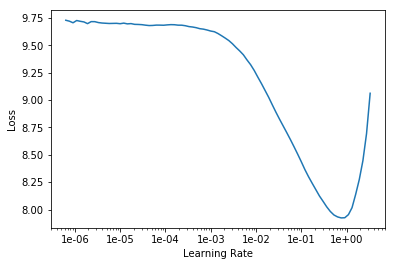

In [0]:
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(1,5e-02,moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,2.978182,2.637025,0.569088,2:56:58


In [0]:
learn.save('/content/drive/My Drive/base_resume_tokens_fit_one_cycle')

In [0]:
learn = learn.load('/content/drive/My Drive/index_4lac_fit_one_cycle')

In [0]:
learn.predict('python',20)

'python junior_data_analyst 4.33 xxbos hexaware associate 4.25 hexaware associate 4.25 xxbos b_a arts_humanities dr_ram_manohar_lohia_avadh_university,_faizabad apollo_pharmacy business_development_executive 2.0 b_a arts_humanities dr_ram_manohar_lohia_avadh_university,_faizabad apollo_pharmacy'

In [0]:
learn.predict('software',20)


'software 0.0 bseb workshop_manager 0.0 xxbos mba / pgdm finance service_executive icici_bank service_executive icici_bank service_executive 9.00 mba / pgdm service_executive icici_bank'

In [0]:
learn.predict('amazon',20)


'amazon south_gujarat_university,_surat amazon resolution_expert amazon specialist thomson_reuters associate_vice_president_sales 1.0 duke_fashions_india_ltd . mis_analyst 1.0 xxbos b_tech_b_e computers jntu_college_of_engineering,_hyderabad mba / pgdm hr'

In [0]:
learn.predict('Flipkart',20)


'Flipkart delivery_boy 1.33 amazon delivery_boy 1.33 xxbos royal_enfield technician 2.0 royal_enfield technician 2.0 xxbos others others kotak_mahindra_prime relationship_manager 5.33 others b_a'

In [0]:
learn.predict('accountant',20)


'accountant 2.33 accountant 2.33 xxbos construction_engineering_and_management no 0.0 b_a no no no 0.0 xxbos b_sc chemistry utkal_university fedex_express_corporation supervisor 1.0 b_sc'

In [0]:
from fastai.text import *

bs=48

In [0]:
path = untar_data(URLs.IMDB)

In [0]:



# path = Path('/jet/.fastai/data/imdb/')

path.ls()

data_lm = (TextList.from_folder(path)
           #Inputs: all the text files in path
            .filter_by_folder(include=['train', 'test', 'unsup']) 
           #We may have other temp folders that contain text files so we only keep what's in train and test
            .split_by_rand_pct(0.1)
           #We randomly split and keep 10% (10,000 reviews) for validation
            .label_for_lm()           
           #We want to do a language model so we label accordingly
            .databunch(bs=bs))
data_lm.save('data_lm.pkl')









In [0]:
def apply_ar(alpha,out): return alpha * out[-1].float().pow(2).mean()

def apply_tar(beta,h): return beta * (h[:,1:] - h[:,:-1]).float().pow(2).mean()

def apply_normstable(beta,h): return beta/h.shape[1] *  (h[:,1:].pow(2).sum() - h[:,:-1].pow(2).sum()).float().pow(2)

class RNNTrainerNorm(LearnerCallback):
    def __init__(self, learn:Learner, alpha:float=2., beta:float=1., beta_norm:float=50.):
        super().__init__(learn)
        self.not_min += ['raw_out', 'out']
        self.alpha,self.beta,self.beta_norm = alpha,beta,beta_norm
        
    def on_epoch_begin(self, **kwargs):
        "Reset the hidden state of the model."
        self.learn.model.reset()

    def on_loss_begin(self, last_output:Tuple[Tensor,Tensor,Tensor], **kwargs):
        "Save the extra outputs for later and only returns the true output."
        self.raw_out,self.out = last_output[1],last_output[2]
        return {'last_output': last_output[0]}

    def on_backward_begin(self, last_loss:Rank0Tensor, last_input:Tensor, **kwargs):
        import pdb;pdb.set_trace()
        "Apply AR and TAR to `last_loss`."
        #AR and TAR
        if self.alpha != 0.:  last_loss += apply_ar(self.alpha,self.out)
        if self.beta != 0.:
            h = self.raw_out[-1]
            if len(h)>1: last_loss += apply_tar(self.beta,h)

        if self.beta_norm != 0.:
            h = self.raw_out[-1]
            if len(h)>1: last_loss += apply_normstable(self.beta_norm,h)        
        
        return {'last_loss': last_loss}



In [0]:

# data_clas = (TextList.from_folder(path, vocab=data_lm.vocab)
data_clas = (TextList.from_folder(path)
             #grab all the text files in path
             .split_by_folder(valid='test')
             #split by train and valid folder (that only keeps 'train' and 'test' so no need to filter)
             .label_from_folder(classes=['neg', 'pos'])
             #label them all with their folders
             .databunch(bs=bs))

data_clas.save('data_clas.pkl')




In [6]:
data_clas

TextClasDataBunch;

Train: LabelList (25000 items)
x: TextList
xxbos i would n't say this is a * bad * movie . xxmaj unfortunately for me , i get the feeling that the more you know about fencing , the worse it gets simply due to the fact that it becomes totally unrealistic . i 've been fencing since i was 14 years old , and this movie portrays it very poorly . xxup f. xxmaj murray xxmaj abraham is good ( and appears to have some fencing background ) , but most of the other actors -- especially the students -- just seem to be lost .,xxbos i was in such high hopes of seeing an adaptation of a classic story like the xxmaj arabian xxmaj nights . xxmaj instead i was disappointed in a film that failed to keep my attention from the very beginning , even though i tried watching it twice ! ! 
 
  xxmaj it was a bonus that xxmaj xxunk was in this movie but it did n't amount to much as the actors lacked likability . xxmaj for something a little similar xxmaj zorro with xxmaj anthony xxmaj hopkins

In [0]:
learn_lm = language_model_learner(data_lm, AWD_LSTM, drop_mult=0.3)
learn_lm.save_encoder('fine_tuned_enc_fit')

In [0]:

learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5)
learn = learn.load_encoder('fine_tuned_enc')


FileNotFoundError: ignored

In [0]:
learn.callbacks = []

In [0]:
path

PosixPath('/root/.fastai/data/imdb')

In [9]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc_fit')
learn.callbacks =[RNNTrainerNorm(learn,2.,1.,500.)]
learn.lr_find()
learn.recorder.plot()
# learn.callbacks = []

RuntimeError: ignored

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time
0,0.484254,0.427817,0.801920,05:05
1,0.453464,0.390344,0.822440,04:47
2,0.434468,0.367014,0.836280,05:00
3,0.441408,0.366696,0.837120,05:17
4,0.429870,0.360675,0.839920,05:04


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


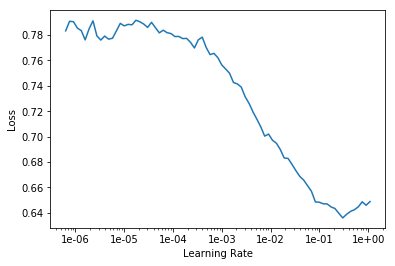

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc')
learn.callbacks =[RNNTrainerNorm(learn,2.,1.,0.)]
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time
0,0.480432,0.407029,0.813720,05:06
1,0.460018,0.382225,0.829520,05:17
2,0.459327,0.367827,0.838080,04:52
3,0.435416,0.361191,0.843280,05:01
4,0.431469,0.355979,0.843760,04:43


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


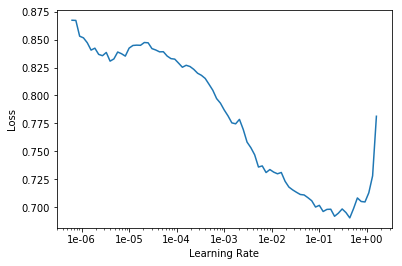

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc')
learn.callbacks =[RNNTrainerNorm(learn,2.,0.,0.)]
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time
0,0.486436,0.408329,0.813280,04:59
1,0.460001,0.392269,0.825920,04:57
2,0.450130,0.367732,0.838480,04:56
3,0.449436,0.359442,0.844960,04:45
4,0.432059,0.354125,0.847080,05:12


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


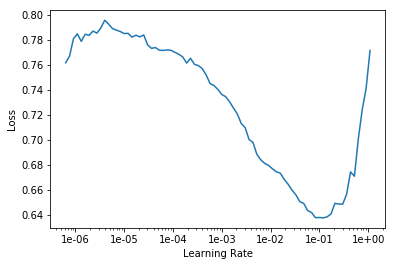

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc')
learn.callbacks =[RNNTrainerNorm(learn,2.,0.,500.)]
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,0.500327,0.403897,0.816600,05:02
1,0.468394,0.382583,0.833040,05:09
2,0.447243,0.367187,0.839360,05:22
3,0.420463,0.357671,0.842480,05:23
4,0.436589,0.360973,0.838720,04:49


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


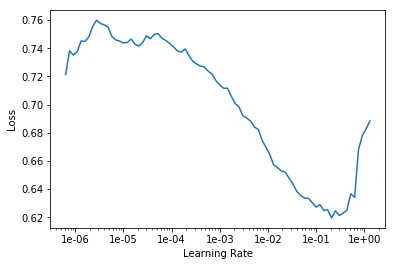

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc')
learn.callbacks =[RNNTrainerNorm(learn,2.,0.,250.)]
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,0.479259,0.405077,0.813840,04:44
1,0.469759,0.386117,0.830640,05:24
2,0.458804,0.377996,0.832520,05:23
3,0.422389,0.355757,0.845160,04:42
4,0.429017,0.356767,0.845680,04:49


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


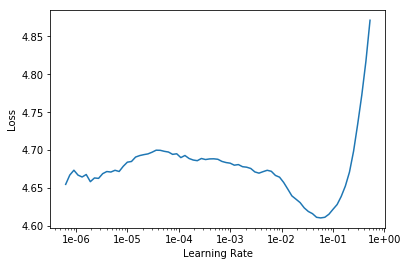

In [0]:
learn_lm.lr_find()
learn_lm.recorder.plot(skip_end=15)


In [0]:
learn_lm.fit_one_cycle(1, 1e-2, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time


KeyboardInterrupt: ignored

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc_fit')
learn.callbacks =[RNNTrainerNorm(learn,2.,1.,0.)]
learn.lr_find()
learn.recorder.plot()

RuntimeError: ignored

In [0]:
learn.fit_one_cycle(5, 1e-2, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,0.435915,0.340860,0.850880,04:37
1,0.432384,0.339566,0.852360,05:16
2,0.409006,0.312028,0.869840,05:19
3,0.401322,0.309930,0.871760,05:21
4,0.383290,0.306796,0.871080,05:14


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


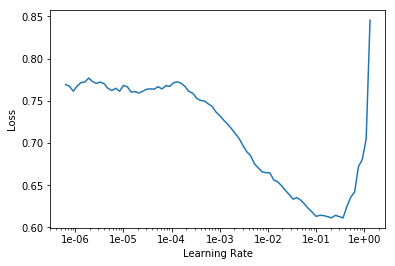

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc_fit')
learn.callbacks =[RNNTrainerNorm(learn,2.,0.,250.)]
learn.lr_find()
learn.recorder.plot()

In [0]:
learn.fit_one_cycle(5, 1e-3, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,0.435816,0.351483,0.846120,05:09
1,0.415328,0.335784,0.855360,04:42
2,0.402185,0.315318,0.866680,04:43
3,0.401174,0.316938,0.865400,05:25
4,0.384461,0.303734,0.872440,05:00


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


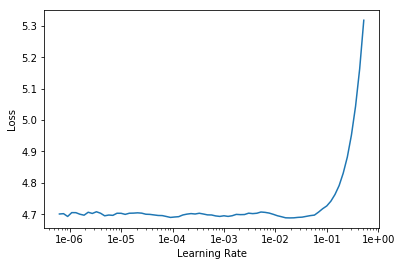

In [0]:

learn_lm = language_model_learner(data_lm, AWD_LSTM, drop_mult=0.3)
learn_lm.callbacks = [RNNTrainerNorm(learn_lm,2.,0.,0.1)]
learn_lm.lr_find()
learn_lm.recorder.plot(skip_end=15)



In [0]:
learn_lm.fit_one_cycle(1, 1e-2, moms=(0.8,0.7))

epoch,train_loss,valid_loss,accuracy,time
0,6.762152,6.676037,0.076175,43:56


In [0]:
import numpy as np
import pandas as pd

from pathlib import Path
from typing import *

import torch
import torch.optim as optim

In [0]:
from fastai import *
from fastai.vision import *
from fastai.text import *
from fastai.callbacks import *

In [0]:
class Config(dict):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        for k, v in kwargs.items():
            setattr(self, k, v)
    
    def set(self, key, val):
        self[key] = val
        setattr(self, key, val)

config = Config(
    testing=False,
    bert_model_name="bert-base-uncased",
    max_lr=3e-5,
    epochs=1,
    use_fp16=False,
    bs=4,
    discriminative=False,
    max_seq_len=128,
)

In [0]:
pip install transformers

     |████████████████████████████████| 296kB 6.3MB/s 
     |████████████████████████████████| 655kB 42.9MB/s 
     |████████████████████████████████| 1.0MB 36.0MB/s 
     |████████████████████████████████| 860kB 36.9MB/s 
  Created wheel for regex: filename=regex-2019.8.19-cp36-cp36m-linux_x86_64.whl size=609242 sha256=325f6f75c15190e68afc80f19363a7234c7e9800453667c81cd18f8beec598e7
  Stored in directory: /root/.cache/pip/wheels/90/04/07/b5010fb816721eb3d6dd64ed5cc8111ca23f97fdab8619b5be
  Created wheel for sacremoses: filename=sacremoses-0.0.34-cp36-none-any.whl size=883992 sha256=189999acb485522637a1d94a9781d1f8a7ddb4778678939a46f40fb8035bf75e
  Stored in directory: /root/.cache/pip/wheels/07/b9/5b/8bd674c23e962fbff34420a9fa7a2c374d591ecadd5bc37684
Successfully built regex sacremoses


In [0]:
pip install pytorch_pretrained_bert

     |████████████████████████████████| 133kB 6.5MB/s 


In [0]:
from pytorch_pretrained_bert import BertTokenizer
bert_tok = BertTokenizer.from_pretrained(
    config.bert_model_name,
)

In [0]:
class FastAiBertTokenizer(BaseTokenizer):
    """Wrapper around BertTokenizer to be compatible with fast.ai"""
    def __init__(self, tokenizer: BertTokenizer, max_seq_len: int=128, **kwargs):
        self._pretrained_tokenizer = tokenizer
        self.max_seq_len = max_seq_len

    def __call__(self, *args, **kwargs):
        return self

    def tokenizer(self, t:str) -> List[str]:
        """Limits the maximum sequence length"""
        return ["[CLS]"] + self._pretrained_tokenizer.tokenize(t)[:self.max_seq_len - 2] + ["[SEP]"]

In [0]:
fastai_tokenizer = Tokenizer(tok_func=FastAiBertTokenizer(bert_tok, max_seq_len=config.max_seq_len), pre_rules=[], post_rules=[])

In [0]:
fastai_bert_vocab = Vocab(list(bert_tok.vocab.keys()))


In [0]:
! wget https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/train.csv
! wget https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/valid.csv
! wget https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/test.csv
! wget https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/test_proced.csv

--2019-10-02 10:02:39--  https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/train.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 120463 (118K) [text/plain]
Saving to: ‘train.csv’

train.csv           100%[===================>] 117.64K  --.-KB/s    in 0.02s   

2019-10-02 10:02:39 (7.27 MB/s) - ‘train.csv’ saved [120463/120463]

--2019-10-02 10:02:43--  https://raw.githubusercontent.com/keitakurita/Practical_NLP_in_PyTorch/master/data/jigsaw/valid.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length:

In [0]:
! mkdir toxic_comments
! mv *.csv toxic_comments

In [0]:
! ls toxic_comments

test.csv  test_proced.csv  train.csv  valid.csv


In [0]:

from sklearn.model_selection import train_test_split

DATA_ROOT = Path("/content/toxic_comments")

train, test = [pd.read_csv(DATA_ROOT / fname, error_bad_lines=False ) for fname in ["train.csv", "test.csv"]]
train, val = train_test_split(train)

if config.testing:
    train = train.head(1024)
    val = val.head(1024)
    test = test.head(1024)

In [0]:
train.sample(20)

NameError: ignored

In [0]:
label_cols = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]

databunch = TextDataBunch.from_df(".", train, val, test,
                  tokenizer=fastai_tokenizer,
                  vocab=fastai_bert_vocab,
                  include_bos=False,
                  include_eos=False,
                  text_cols="comment_text",
                  label_cols=label_cols,
                  bs=config.bs,
                  collate_fn=partial(pad_collate, pad_first=False, pad_idx=0),
             )

In [0]:
data_clas.show_batch()

text,target
xxbos xxmaj match 1 : xxmaj tag xxmaj team xxmaj table xxmaj match xxmaj bubba xxmaj ray and xxmaj spike xxmaj dudley vs xxmaj eddie xxmaj guerrero and xxmaj chris xxmaj benoit xxmaj bubba xxmaj ray and xxmaj spike xxmaj dudley started things off with a xxmaj tag xxmaj team xxmaj table xxmaj match against xxmaj eddie xxmaj guerrero and xxmaj chris xxmaj benoit . xxmaj according to the rules,pos
"xxbos xxmaj warning : xxmaj does contain spoilers . \n \n xxmaj open xxmaj your xxmaj eyes \n \n xxmaj if you have not seen this film and plan on doing so , just stop reading here and take my word for it . xxmaj you have to see this film . i have seen it four times so far and i still have n't made up my",pos
"xxbos xxmaj jim xxmaj carrey is back to much the same role that he played in xxmaj the xxmaj mask , a timid guy who is trying to get ahead in the world but who seems to be plagued with bad luck . xxmaj even when he tries to help a homeless guy from being harassed by a bunch of hoodlums ( and of course they have to be xxmaj",pos
"xxbos xxmaj in xxup nyc , seaman xxmaj michael o'hara ( xxmaj orson xxmaj welles ) rescues xxmaj elsa xxmaj bannister ( xxmaj rita xxmaj hayworth ) from a mugging & rape as she takes a horse & carriage through xxmaj central xxmaj park -and lives to regret it . xxmaj xxunk - haired xxmaj hayworth 's a platinum blonde in this one ; as dazzling as fresh - fallen",pos
"xxbos xxmaj the premise of this movie has been tickling my imagination for quite some time now . xxmaj we 've all heard or read about it in some kind of con - text . xxmaj what would you do if you were all alone in the world ? xxmaj what would you do if the entire world suddenly disappeared in front of your eyes ? xxmaj in fact ,",pos


In [0]:
from pytorch_pretrained_bert.modeling import BertConfig, BertForSequenceClassification
bert_model = BertForSequenceClassification.from_pretrained(config.bert_model_name, num_labels=2)

In [0]:
loss_func = nn.CrossEntropyLoss()


In [0]:
learner = Learner(
    data_clas, bert_model,
    loss_func=loss_func,
)

In [0]:
learner.lr_find()


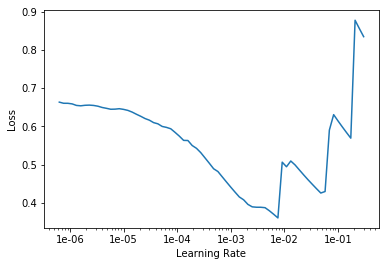

In [0]:
learner.recorder.plot()


In [0]:
config.max_lr

3e-05

In [0]:
learner.fit_one_cycle(1,1e-4)

epoch,train_loss,valid_loss,time
0,0.253901,0.184449,00:11


In [0]:
def get_preds_as_nparray(ds_type) -> np.ndarray:
    """
    the get_preds method does not yield the elements in order by default
    we borrow the code from the RNNLearner to resort the elements into their correct order
    """
    preds = learner.get_preds(ds_type)[0].detach().cpu().numpy()
    sampler = [i for i in databunch.dl(ds_type).sampler]
    reverse_sampler = np.argsort(sampler)
    return preds[reverse_sampler, :]

In [0]:
test_preds = get_preds_as_nparray(test)


ValueError: ignored

In [0]:
from transformers import BertTokenizer,BertForSequenceClassification
import torch 

In [0]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [0]:
model = BertForSequenceClassification.from_pretrained('bert-base-uncased')

NameError: ignored

In [0]:
input_ids = torch.tensor(tokenizer.encode("Hello, my dog is cute")).unsqueeze(0)  # Batch size 1

In [0]:
input_ids

tensor([[ 7592,  1010,  2026,  3899,  2003, 10140]])

In [0]:
labels = torch.tensor([1]).unsqueeze(0)

In [0]:
labels

tensor([[1]])

In [0]:
! head /root/.fastai/data/imdb/train/pos/11727_7.txt

This film is fun, if your a person who likes a good campy feature film every now and then. By no means is this movie fine cinema, but if you dont take things too seriously, and can laugh at yourself once in a while, Elvira is a good frownbuster.

In [0]:
data_clas = (TextList.from_folder(path, vocab=fastai_bert_vocab)
             #grab all the text files in path
             .split_by_folder(valid='test')
             #split by train and valid folder (that only keeps 'train' and 'test' so no need to filter)
             .label_from_folder(classes=['neg', 'pos'])
             .transform([fastai_tokenizer,fastai_tokenizer])
             #label them all with their folders
             .databunch(bs=config.bs))

Exception: ignored

In [0]:
databunch = TextDataBunch.from_df(".", train, val, test,
                  tokenizer=fastai_tokenizer,
                  vocab=fastai_bert_vocab,
                  include_bos=False,
                  include_eos=False,
                  text_cols="comment_text",
                  label_cols=label_cols,
                  bs=config.bs,
                  collate_fn=partial(pad_collate, pad_first=False, pad_idx=0),
             )

In [0]:
learn_lm = language_model_learner(data_lm, Transformer, drop_mult=0.3)
# learn_lm.callbacks = [RNNTrainerNorm(learn_lm,2.,0.,0.1)]
# learn_lm.lr_find()


In [0]:
learn_lm.save_encoder('fine_tuned_enc_transformer')

In [0]:
import gc

In [0]:
learn_lm = None
gc.collect()

899

In [0]:
learn = text_classifier_learner(data_clas, Transformer, drop_mult=0.5,)
learn = learn.load_encoder('fine_tuned_enc_transformer')
learn.lr_find()
learn.recorder.plot()

RuntimeError: ignored

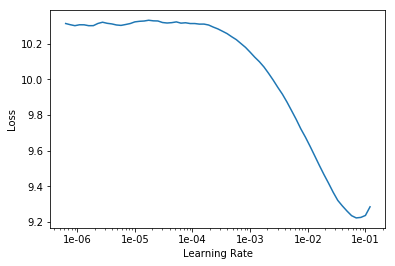

In [0]:
# learn_lm.recorder.plot(skip_end=15)


In [0]:
# learn_lm.fit_one_cycle(1, 5e-3, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time


/pytorch/aten/src/ATen/native/cuda/LegacyDefinitions.cpp:14: UserWarning: masked_fill_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead.
/pytorch/aten/src/ATen/native/cuda/LegacyDefinitions.cpp:14: UserWarning: masked_fill_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead.
/pytorch/aten/src/ATen/native/cuda/LegacyDefinitions.cpp:14: UserWarning: masked_fill_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead.
/pytorch/aten/src/ATen/native/cuda/LegacyDefinitions.cpp:14: UserWarning: masked_fill_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead.
/pytorch/aten/src/ATen/native/cuda/LegacyDefinitions.cpp:14: UserWarning: masked_fill_ received a mask with dtype torch.uint8, this behavior is now deprecated,please us

In [0]:
from torchvision import models


In [0]:
pretrained_model = models.resnet34(pretrained=True)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 83.3M/83.3M [00:02<00:00, 35.9MB/s]


In [0]:
list(pretrained_model.children())

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False),
 BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False),
 Sequential(
   (0): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   )
   (1): BasicBlock(
     (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), pad

In [0]:

from fastai.vision import *
from fastai.metrics import error_rate

In [0]:
bs = 64


In [0]:
path_ = untar_data(URLs.PETS); path_


PosixPath('/root/.fastai/data/oxford-iiit-pet')

In [0]:
path_anno = path_/'annotations'
path_img = path_/'images'

In [0]:
fnames = get_image_files(path_img)
np.random.seed(2)
pat = r'/([^/]+)_\d+.jpg$'
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs
                                  ).normalize(imagenet_stats)

In [0]:
path_img

PosixPath('/root/.fastai/data/oxford-iiit-pet/images')

In [0]:
print(data.classes)
len(data.classes),data.c

['Abyssinian', 'Bengal', 'Birman', 'Bombay', 'British_Shorthair', 'Egyptian_Mau', 'Maine_Coon', 'Persian', 'Ragdoll', 'Russian_Blue', 'Siamese', 'Sphynx', 'american_bulldog', 'american_pit_bull_terrier', 'basset_hound', 'beagle', 'boxer', 'chihuahua', 'english_cocker_spaniel', 'english_setter', 'german_shorthaired', 'great_pyrenees', 'havanese', 'japanese_chin', 'keeshond', 'leonberger', 'miniature_pinscher', 'newfoundland', 'pomeranian', 'pug', 'saint_bernard', 'samoyed', 'scottish_terrier', 'shiba_inu', 'staffordshire_bull_terrier', 'wheaten_terrier', 'yorkshire_terrier']


(37, 37)

In [0]:
learn = cnn_learner(data, models.resnet34, metrics=error_rate)


Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 87.4MB/s]


In [0]:
models.resnet34??

In [0]:
learn.fit_one_cycle(4)


epoch,train_loss,valid_loss,error_rate,time
0,1.361462,0.390792,0.115697,00:56
1,0.599056,0.284831,0.093369,00:56
2,0.371236,0.286066,0.089986,00:57
3,0.264373,0.261672,0.087957,00:56


In [0]:
url_coco = 'http://images.cocodataset.org/zips/train2014.zip'

In [0]:
! wget http://images.cocodataset.org/zips/train2014.zip

In [0]:
! wget http://images.cocodataset.org/zips/val2014.zip

In [0]:
! unzip val2014.zip 

In [0]:
! unzip train2014.zip 

In [0]:
! mkdir coco && mv *2014 coco 

In [0]:
! ls

annotations		      sample_data  train2014.zip  val2014.zip
annotations_trainval2014.zip  train2014    val2014


In [0]:
! unzip annotations_trainval2014.zip

In [0]:
! wget http://images.cocodataset.org/annotations/annotations_trainval2014.zip

In [0]:
! ls  annotations/

captions_train2014.json   instances_val2014.json
captions_val2014.json	  person_keypoints_train2014.json
instances_train2014.json  person_keypoints_val2014.json


In [0]:
from fastai import * 
from fastai.text import * 
from fastai.vision import * 
from pathlib import Path 

In [0]:
path = Path('/content')


In [0]:
labels = {}

In [0]:
def extract_labels_from_json(path):
  import json
  f = open(path)
  data = json.load(f)

  for it in data['annotations']: labels[it['image_id']] = it['caption']

In [0]:
extract_labels_from_json(path/'annotations/captions_train2014.json')
extract_labels_from_json(path/'annotations/captions_val2014.json')

In [0]:
! ls 

annotations		      coco	   train2014.zip
annotations_trainval2014.zip  sample_data  val2014.zip


In [0]:
from torch.utils.data import Dataset, DataLoader


In [0]:
! ls coco

train2014  val2014


In [0]:
coco_imgs = path/'coco'

In [0]:
def get_caption_for_image(x):
  key = x.name.split('_')[2].split('.')[0]
  key = int(key)
  return labels[key]

def ret_1(x): return '1'


In [0]:
ImageList._bunch = ImageDataBunch

a = (ImageList.from_folder(coco_imgs)
    .split_by_folder('train2014','val2014')
    # .label_from_func(func=get_caption_for_image,label_cls=TextList)
    .label_from_func(func=ret_1,label_cls=CategoryList)

    # .databunch(no_check=True)
    )

b = (ImageList.from_folder(coco_imgs)
    .split_by_folder('train2014','val2014')
    .label_from_func(func=get_caption_for_image,label_cls=TextList)
    # .label_from_func(func=ret_1,label_cls=TextList)

    # .databunch(no_check=True)
    )

You can deactivate this warning by passing `no_check=True`.


/usr/local/lib/python3.6/dist-packages/fastai/basic_data.py:271: UserWarning: It's not possible to collate samples of your dataset together in a batch.
Shapes of the inputs/targets:
[[torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.

In [0]:
p.show_batch()

Output hidden; open in https://colab.research.google.com to view.

In [0]:
fnames = get_image_files(path_img)
np.random.seed(2)
pat = r'/([^/]+)_\d+.jpg$'

In [0]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224, bs=64)

In [0]:
import re 
pat = re.compile(pat)
def _get_label(fn):
    if isinstance(fn, Path): fn = fn.as_posix()
    res = pat.search(str(fn))
    assert res,f'Failed to find "{pat}" in "{fn}"'
    return res.group(1)


In [0]:
t = ImageList(fnames, path=path_img).split_by_rand_pct(0.2, None).label_from_func(_get_label)


In [0]:
t_ = t.databunch(bs=64,ds_tfms=get_transforms(),size=224)

In [0]:
t_ = ImageDataBunch.create_from_ll(t,bs=64,ds_tfms=get_transforms(),size=224)

In [0]:
get_transforms()

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmPixel (flip_lr), kwargs={}, p=0.5, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmCoord (symmetric_warp), kwargs={'magnitude': (-0.2, 0.2)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmAffine (zoom), kwargs={'scale': (1.0, 1.1), 'row_pct': (0, 1), 'col_pct': (0, 1)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.4, 0.6)}, p=0.75, resolved={}, do_run=True, is_random=True, use_on_y=True),
  RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.8, 1.25)}, p=0.75, resolved={}, do

In [0]:
next(iter(b.train))

(Image (3, 224, 224),
 Text xxbos a close up of a person talking on a cell phone)

In [0]:
next(iter(a.train))


(Image (3, 224, 224), Category 1)

In [0]:
t_.dl()

DeviceDataLoader(dl=<torch.utils.data.dataloader.DataLoader object at 0x7f054fd9eb38>, device=device(type='cuda'), tfms=[], collate_fn=<function data_collate at 0x7f05b09b0378>)

In [0]:
class P_IDB(ImageDataBunch):

    def sanity_check(self):

        import pdb;pdb.set_trace()
      
        "Check the underlying data in the training set can be properly loaded."
        final_message = "You can deactivate this warning by passing `no_check=True`."
        if not hasattr(self.train_ds, 'items') or len(self.train_ds.items) == 0 or not hasattr(self.train_dl, 'batch_sampler'): return
        if len(self.train_dl) == 0:
            warn(f"""Your training dataloader is empty, you have only {len(self.train_dl.dataset)} items in your training set.
                 Your batch size is {self.train_dl.batch_size}, you should lower it.""")
            print(final_message)
            return
        idx = next(iter(self.train_dl.batch_sampler))
        samples,fails = [],[]
        for i in idx:
            try:    samples.append(self.train_dl.dataset[i])
            except: fails.append(i)
        if len(fails) > 0:
            warn_msg = "There seems to be something wrong with your dataset, for example, in the first batch can't access"
            if len(fails) == len(idx):
                warn_msg += f" any element of self.train_ds.\nTried: {show_some(idx)}"
            else:
                warn_msg += f" these elements in self.train_ds: {show_some(fails)}"
            warn(warn_msg)
            print(final_message)
            return
        try: batch = self.collate_fn(samples)
        except:
            message = "It's not possible to collate samples of your dataset together in a batch."
            try:
                shapes = [[o[i].data.shape for o in samples] for i in range(2)]
                message += f'\nShapes of the inputs/targets:\n{shapes}'
            except: pass
            warn(message)
            print(final_message)  

In [0]:
p = P_IDB.create_from_ll(b,bs=64,ds_tfms=get_transforms(),size=224)

You can deactivate this warning by passing `no_check=True`.


/usr/local/lib/python3.6/dist-packages/fastai/basic_data.py:271: UserWarning: It's not possible to collate samples of your dataset together in a batch.
Shapes of the inputs/targets:
[[torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.Size([3, 224, 224]), torch.

In [0]:
p.show_batch()

Output hidden; open in https://colab.research.google.com to view.

LSUV Experiments 


In [0]:
bs=48

path = untar_data(URLs.IMDB)
path.ls()


[PosixPath('/root/.fastai/data/imdb/train'),
 PosixPath('/root/.fastai/data/imdb/test'),
 PosixPath('/root/.fastai/data/imdb/unsup'),
 PosixPath('/root/.fastai/data/imdb/README'),
 PosixPath('/root/.fastai/data/imdb/tmp_clas'),
 PosixPath('/root/.fastai/data/imdb/tmp_lm'),
 PosixPath('/root/.fastai/data/imdb/data_lm.pkl'),
 PosixPath('/root/.fastai/data/imdb/imdb.vocab'),
 PosixPath('/root/.fastai/data/imdb/data_clas.pkl'),
 PosixPath('/root/.fastai/data/imdb/models')]

In [0]:

data_lm = (TextList.from_folder(path)
           #Inputs: all the text files in path
            .filter_by_folder(include=['train', 'test', 'unsup']) 
           #We may have other temp folders that contain text files so we only keep what's in train and test
            .split_by_rand_pct(0.1)
           #We randomly split and keep 10% (10,000 reviews) for validation
            .label_for_lm()           
           #We want to do a language model so we label accordingly
            .databunch(bs=bs))
data_lm.save('data_lm.pkl')

In [0]:
learn = language_model_learner(data_lm, AWD_LSTM, drop_mult=0.3)


In [0]:
learn.fit_one_cycle(1, 1e-2, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time
0,4.170007,4.019156,0.296205,1:24:22


In [0]:
learn.save_encoder('fine_tuned_enc')


In [0]:
path = untar_data(URLs.IMDB)


In [0]:

data_clas = (TextList.from_folder(path, vocab=data_lm.vocab)
             #grab all the text files in path
             .split_by_folder(valid='test')
             #split by train and valid folder (that only keeps 'train' and 'test' so no need to filter)
             .label_from_folder(classes=['neg', 'pos'])
             #label them all with their folders
             .databunch(bs=bs))

data_clas.save('data_clas.pkl')

In [0]:
learn = text_classifier_learner(data_clas, AWD_LSTM, drop_mult=0.5,)
# learn.lr_find()
# learn.recorder.plot()

In [0]:
learn = learn.load_encoder('fine_tuned_enc')


RuntimeError: ignored

In [0]:
learn.fit_one_cycle(1, 2e-2, moms=(0.8,0.7))


epoch,train_loss,valid_loss,accuracy,time


KeyboardInterrupt: ignored